<a href="https://colab.research.google.com/github/templar137/AI_project/blob/main/SC2_Cinematic_remastering_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow import keras
from keras.layers import Conv2D, Input, Activation
from keras.models import Model
from keras.callbacks import ModelCheckpoint
from skimage.transform import pyramid_expand
import tensorflow as tf
import os
from keras.preprocessing.image import ImageDataGenerator
from PIL import Image
from keras.preprocessing.image import img_to_array
import shutil

In [3]:
import tensorflow as tf
run_opts = tf.compat.v1.RunOptions(report_tensor_allocations_upon_oom=True)
runmeta = tf.compat.v1.RunMetadata()

In [4]:
x_train_dir = '/content/x_train/'
y_train_dir = '/content/y_train/'
x_test_dir = '/content/x_test/'
y_test_dir = '/content/y_test/'
os.mkdir(x_train_dir)
os.mkdir(y_train_dir)
os.mkdir(x_test_dir)
os.mkdir(y_test_dir)

In [ ]:
shutil.rmtree(x_train_dir)
shutil.rmtree(y_train_dir)
shutil.rmtree(x_test_dir)
shutil.rmtree(y_test_dir)
# os.rmdir(x_train_dir)
# os.rmdir(y_train_dir)
# os.rmdir(x_test_dir)
# os.rmdir(y_test_dir)

In [5]:
vidcap = cv2.VideoCapture('/content/gdrive/MyDrive/Dataset/SC2 Super Resolution/360p_30fps.mp4') 
count = 0 
while(vidcap.isOpened()):
   ret, image = vidcap.read()
   # 30프레임당 하나씩 이미지 추출 
   if(int(vidcap.get(1)) % 24 == 0):  ## 이걸 만들어 둔 이유가 램부족떄문입니다!
     cv2.imwrite("/content/x_train/%d.jpg" % count, image)
   elif(int(vidcap.get(1)) % 247 == 0): 
     cv2.imwrite("/content/x_test/%d.jpg" % count, image)
  #  print('Saved frame%d.jpg' % count) 
   count += 1 
   if count == 4944:
     break
vidcap.release()

In [6]:
vidcap = cv2.VideoCapture('/content/gdrive/MyDrive/Dataset/SC2 Super Resolution/720p_30fps.mp4') 
count = 0
while(vidcap.isOpened()):
   ret, image = vidcap.read() 
   # 30프레임당 하나씩 이미지 추출 
   if(int(vidcap.get(1)) % 24 == 0): ## 이걸 만들어 둔 이유가 램부족떄문입니다!
     cv2.imwrite("/content/y_train/%d.jpg" % count, image)
   elif(int(vidcap.get(1)) % 247 == 0): 
     cv2.imwrite("/content/y_test/%d.jpg" % count, image)
  #  print('Saved frame%d.jpg' % count) 
   if count == 4944:
     break
   count += 1 
vidcap.release()

In [7]:
name_x_train = sorted(os.listdir('/content/x_train'))
name_y_train = sorted(os.listdir('/content/y_train'))
name_x_test = sorted(os.listdir('/content/x_test'))
name_y_test = sorted(os.listdir('/content/y_test'))

In [8]:
x_train = []

for i in name_x_train:
    
    img1 = cv2.cvtColor(cv2.imread('/content/x_train/' + i), cv2.COLOR_BGR2RGB)
    
    x_train.append(img_to_array(Image.fromarray(img1)))
x_train = np.array(x_train)
x_train = x_train / 255.0

In [9]:
y_train = []

for i in name_y_train:
    img1 = cv2.cvtColor(cv2.imread('/content/y_train/' + i), cv2.COLOR_BGR2RGB)
    y_train.append(img_to_array(Image.fromarray(img1)))
y_train = np.array(y_train)
y_train = y_train / 255.0

In [10]:
x_test = []

for i in name_x_test:
    
    img1 = cv2.cvtColor(cv2.imread('/content/x_test/' + i), cv2.COLOR_BGR2RGB)
    
    x_test.append(img_to_array(Image.fromarray(img1)))

x_test = np.array(x_test)
x_test = x_test / 255.0

In [12]:
y_test = []

for i in name_y_test:
    img1 = cv2.cvtColor(cv2.imread('/content/y_test/' + i), cv2.COLOR_BGR2RGB)
    y_test.append(img_to_array(Image.fromarray(img1)))

y_test = np.array(y_test)
y_test = y_test / 255.0

In [13]:
x_train_resized = []
for i in name_x_train:
  subset = cv2.imread('/content/x_train/' + i)
  subset = cv2.pyrUp(subset)
  img1 = cv2.cvtColor(subset, cv2.COLOR_BGR2RGB)
  x_train_resized.append(img_to_array(Image.fromarray(img1)))

x_train_resized = np.array(x_train_resized)
x_train_resized = x_train_resized / 255.0

In [14]:
x_test_resized = []
for i in name_x_test:
  subset = cv2.imread('/content/x_test/' + i)
  subset = cv2.pyrUp(subset)
  img1 = cv2.cvtColor(subset, cv2.COLOR_BGR2RGB)
  x_test_resized.append(img_to_array(Image.fromarray(img1)))

x_test_resized = np.array(x_test_resized)
x_test_resized = x_test_resized / 255.0

In [ ]:
subset

array([[[18, 15, 17],
        [18, 15, 17],
        [18, 15, 17],
        ...,
        [17, 14, 16],
        [17, 14, 16],
        [17, 14, 16]],

       [[18, 15, 17],
        [18, 15, 17],
        [18, 15, 17],
        ...,
        [17, 14, 16],
        [17, 14, 16],
        [17, 14, 16]],

       [[18, 15, 17],
        [18, 15, 17],
        [18, 15, 17],
        ...,
        [17, 14, 16],
        [17, 14, 16],
        [17, 14, 16]],

       ...,

       [[17, 14, 16],
        [17, 14, 16],
        [17, 14, 16],
        ...,
        [17, 14, 16],
        [17, 14, 16],
        [17, 14, 16]],

       [[17, 14, 16],
        [17, 14, 16],
        [17, 14, 16],
        ...,
        [17, 14, 16],
        [17, 14, 16],
        [17, 14, 16]],

       [[17, 14, 16],
        [17, 14, 16],
        [17, 14, 16],
        ...,
        [17, 14, 16],
        [17, 14, 16],
        [17, 14, 16]]], dtype=uint8)

In [ ]:
np.save('/content/gdrive/MyDrive/Dataset/SC2 Super Resolution/x_train', x_train)
np.save('/content/gdrive/MyDrive/Dataset/SC2 Super Resolution/y_train', y_train)
np.save('/content/gdrive/MyDrive/Dataset/SC2 Super Resolution/x_test', x_test)
np.save('/content/gdrive/MyDrive/Dataset/SC2 Super Resolution/y_test', y_test)

In [15]:
x_test_resized.shape

(20, 720, 1280, 3)

In [16]:
x_test_resized.shape

(20, 720, 1280, 3)

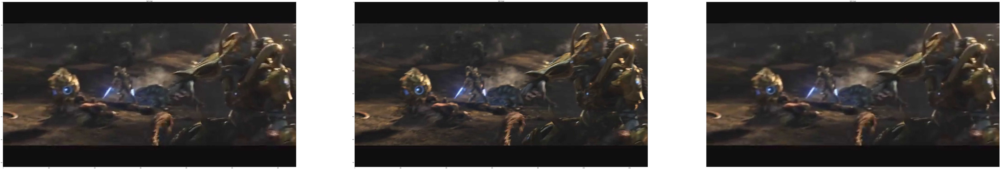

In [ ]:
plt.figure(figsize = (200,120))
i = 1
plt.subplot(1,3,1)
plt.imshow(x_test[i])
plt.title('light Image')
plt.subplot(1,3,2)
plt.imshow(y_test[i])
plt.title('light Image')
plt.subplot(1,3,3)
plt.imshow(x_test_resized[i])
plt.axis('off')
plt.title('light Image')
    
plt.show()

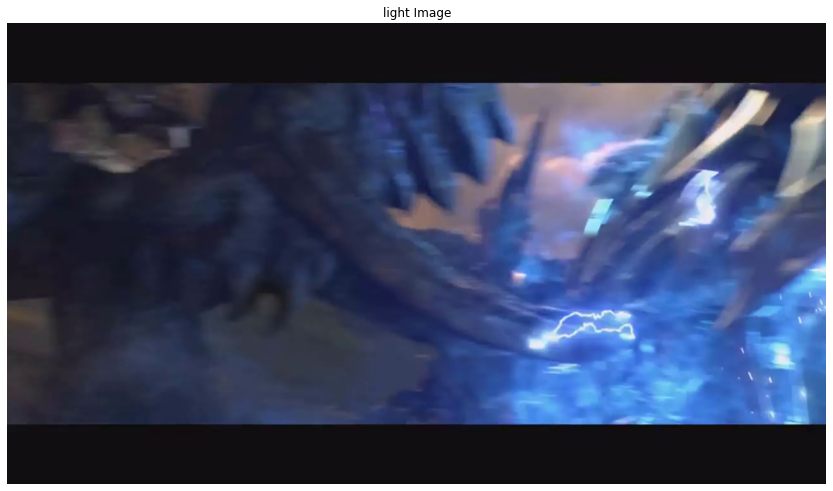

In [ ]:

plt.figure(figsize = (200,100))

i = 0

plt.subplot(10, 2, i+1)
plt.imshow(y_test[10])
plt.axis('off')
plt.title('light Image')
    
plt.show()

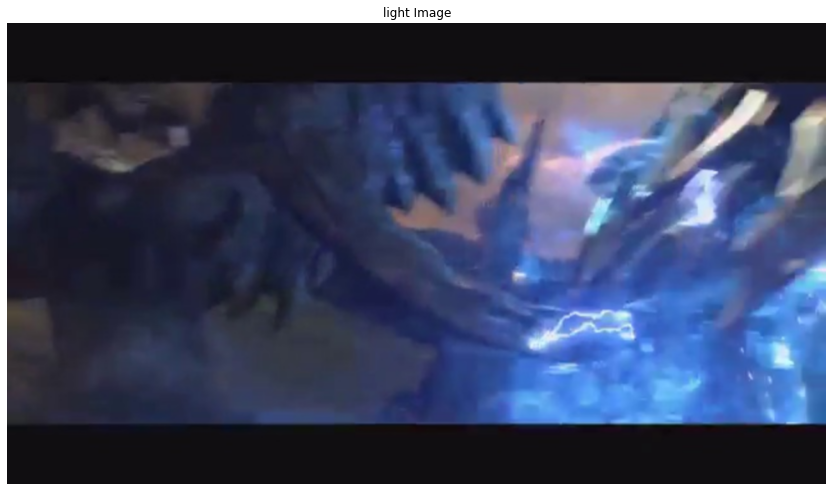

In [ ]:

plt.figure(figsize = (200,100))

i = 0

plt.subplot(10, 2, i+1)
plt.imshow(x_test_resized[10])
plt.axis('off')
plt.title('light Image')
    
plt.show()

In [17]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)
print(x_train_resized.shape)
print(x_test_resized.shape)

(206, 360, 640, 3)
(206, 720, 1280, 3)
(20, 360, 640, 3)
(20, 720, 1280, 3)
(206, 720, 1280, 3)
(20, 720, 1280, 3)


In [18]:
upscale_factor = 4

inputs = keras.Input(shape=(720, 1280, 3))
x = inputs
x = tf.keras.layers.Conv2D(64, (5, 5), activation='relu', padding="same")(x)
x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding="same")(x)
x = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', padding="same")(x)
x = tf.keras.layers.Conv2D(upscale_factor ** 2, (3, 3), activation='relu', padding="same")(x)
x = tf.keras.layers.UpSampling2D(size=(2, 2))(x)
_x = tf.keras.layers.Conv2D(64, (5, 5), activation='relu', padding="same")(x)
x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding="same")(_x)
x = tf.keras.layers.Conv2D(128, (1, 1), activation='relu', padding="same")(x)
x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding="same")(x)
x = x + _x
x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding="same")(x)
# x = tf.keras.layers.Conv2DTranspose(upscale_factor ** 2, (3, 3), activation='relu', strides=(2, 2), padding="same")(x)
outputs = tf.keras.layers.Conv2D(3, (1,1), padding="same", activation="sigmoid")(x)   

model = tf.keras.models.Model(inputs=inputs, outputs=outputs)
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0003)
model.compile(optimizer=optimizer, loss='mse', metrics=['mean_squared_error'])

model.summary()


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 720, 1280, 3 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 720, 1280, 64 4864        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 720, 1280, 64 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 720, 1280, 32 18464       conv2d_1[0][0]                   
______________________________________________________________________________________________

In [22]:
checkpoint_path = '/content/model/'
os.mkdir(checkpoint_path)

In [21]:
model.fit(x_train_resized, y_train, batch_size=8, validation_data = (x_test_resized, y_test),
          epochs=100, verbose=10, callbacks=[ModelCheckpoint('/content/model/model.h5', monitor='val_loss', verbose=1, save_best_only=True)])

Epoch 1/100


ResourceExhaustedError: ignored

In [91]:
# predict = model.predict(x_test_resized)
predict = model.predict(x_test_resized[1], batch_size=16)
# predict = cv2.cvtColor(predict, cv2.COLOR_BGR2RGB)

ValueError: ignored

In [87]:
len(x_test_resized)

20

In [88]:
x_test_resized = tf.convert_to_tensor(x_test_resized, dtype=tf.float32)

In [ ]:
x

In [86]:
print(x_test.shape)
print(predict.shape)

(20, 360, 640, 3)
(20, 720, 1280, 3)


In [82]:
predict[1]

array([[[0.4996174 , 0.49961978, 0.4994588 ],
        [0.49947456, 0.49937102, 0.4993273 ],
        [0.49957395, 0.49926034, 0.49935257],
        ...,
        [0.49957407, 0.49930176, 0.49933925],
        [0.4997987 , 0.49973503, 0.49955538],
        [0.4998446 , 0.49976575, 0.4997171 ]],

       [[0.4992756 , 0.49968275, 0.49894425],
        [0.49890372, 0.4993715 , 0.49870667],
        [0.49908435, 0.49947935, 0.49899554],
        ...,
        [0.4994477 , 0.49941328, 0.4990448 ],
        [0.49995315, 0.4997577 , 0.4992012 ],
        [0.50006485, 0.49984902, 0.4994733 ]],

       [[0.49907568, 0.49962977, 0.49891967],
        [0.49864933, 0.4993256 , 0.4983314 ],
        [0.49890888, 0.4994394 , 0.49858874],
        ...,
        [0.49904695, 0.49958175, 0.49919918],
        [0.4997973 , 0.49988905, 0.49928576],
        [0.5000424 , 0.49987856, 0.49949828]],

       ...,

       [[0.49882078, 0.4999006 , 0.49904594],
        [0.49849904, 0.49955136, 0.49835256],
        [0.49866593, 0

In [83]:
predict = (predict * 255).astype(np.uint8)

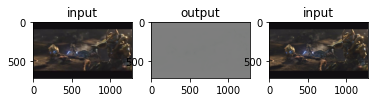

In [84]:
i = 1
plt.subplot(1, 3, 1)
plt.title('input')
plt.imshow(x_test_resized[i])
plt.subplot(1, 3, 2)
plt.title('output')
plt.imshow(predict[i])
plt.subplot(1, 3, 3)
plt.title('input')
plt.imshow(y_test[i])

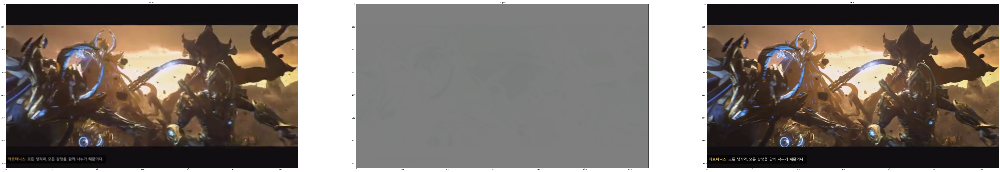

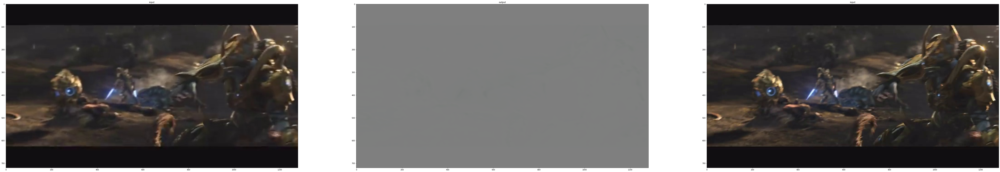

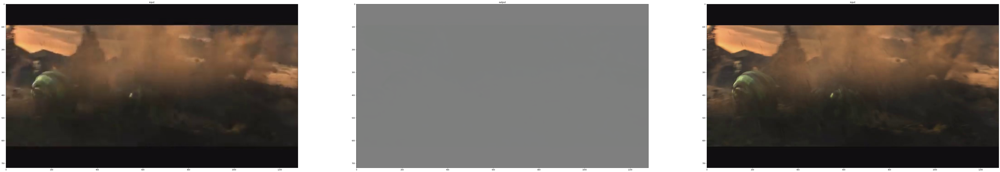

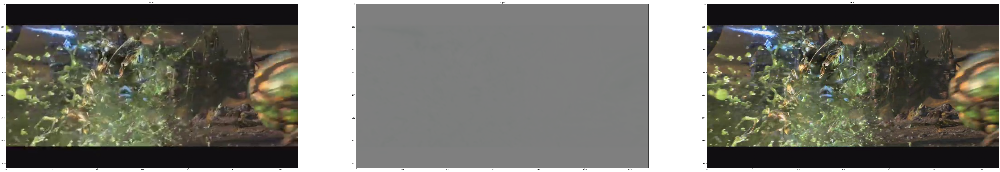

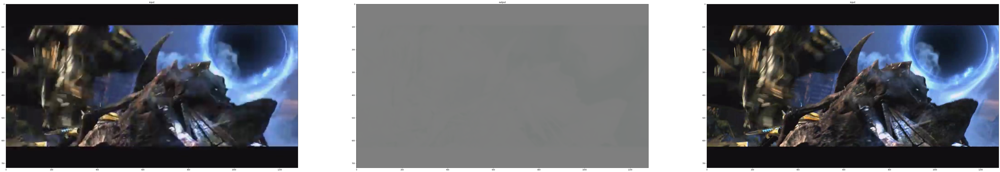

...

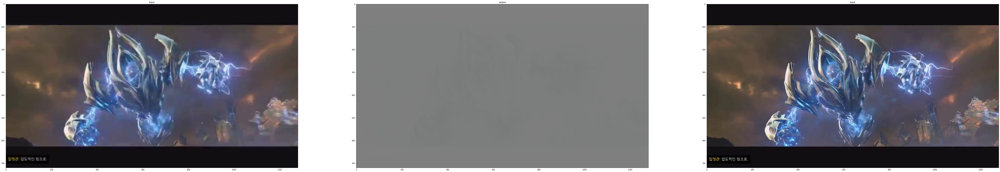

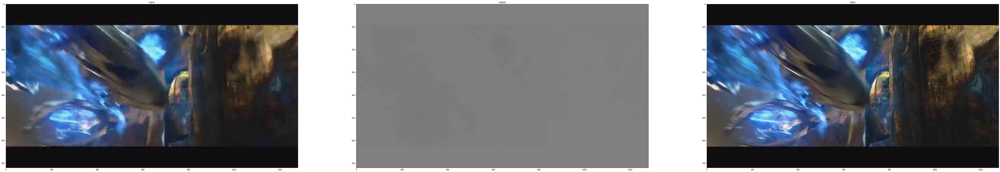

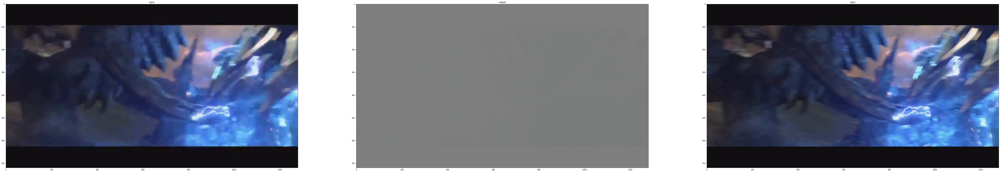

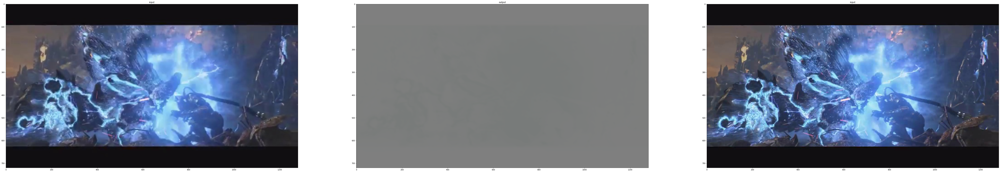

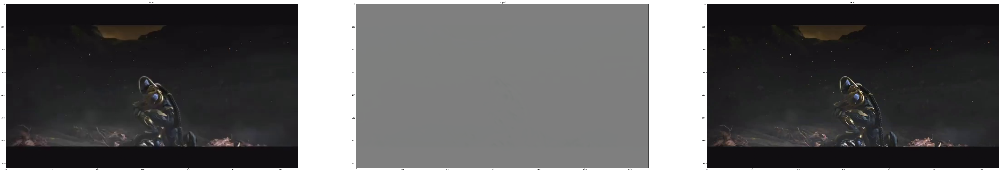

Error in callback <function flush_figures at 0x7f52df13f170> (for post_execute):


KeyboardInterrupt: ignored

In [65]:
for i in range(len(predict)):
  plt.figure(figsize=(100, 50))
  plt.subplot(1, 3, 1)
  plt.title('input')
  plt.imshow(x_test_resized[i])
  plt.subplot(1, 3, 2)
  plt.title('output')
  plt.imshow(predict[i])
  plt.subplot(1, 3, 3)
  plt.title('input')
  plt.imshow(y_test[i])

In [ ]:
x_test_1 = cv2.resize(x_test[1], (854, 480))

In [ ]:
x_test_1.shape

(480, 854, 3)

In [ ]:
import math
def rmse_score(true, pred):
    score = math.sqrt(np.mean((true-pred)**2))
    return score

def psnr_score(true, pred, pixel_max):
    score = 20*np.log10(pixel_max/rmse_score(true, pred))
    return score

In [ ]:
x_test_resize = []
for i in range(len(predict)):
  x_new = cv2.resize(x_test[i], (854, 480))
  x_test_resize.append(x_new)
x_test_resize  = np.array(x_test_resize)

In [ ]:
x_test_resize.shape

(18, 480, 854, 3)

In [ ]:
mean_predict, mean_org = 0, 0
for i in range(len(predict)):
  mean_org += psnr_score(x_test_resize[i], y_test[i],1)
  mean_predict += psnr_score(predict[i], y_test[i],1)
  print(i,' 번째:', psnr_score(predict[i], y_test[i],1) - psnr_score(x_test_resize[i], y_test[i],1))
  # print(i,' 번째 predict psnr:', psnr_score(x_test_resize[i], y_test[i],1))

# mean_predict, mean_org = mean_predict / len(predict), mean_org / len(predict)
# print('original mean psnr:', mean_org)
# print('predict mean psnr:', mean_predict)

0  번째: 0.3278304143902879
1  번째: 0.6304318302151017
2  번째: -1.3443915369107877
3  번째: -1.1101130022721613
4  번째: 0.06641012994008122
5  번째: 2.9667700423813024
6  번째: -0.07392869259252777
7  번째: -0.195876007328188
8  번째: 0.32922069597389836
9  번째: 0.2446235311443452
10  번째: 1.1626751451978592
11  번째: 1.3061465927159155
12  번째: 0.6307268112687154
13  번째: 2.1201973203034328
14  번째: 2.2315464287106224
15  번째: 0.33688392075410434
16  번째: 0.8441349478197253
17  번째: 0.712439589762873


In [ ]:
print('input psnr:', psnr_score(x_test_1, y_test[1],1))
print('output psnr:', psnr_score(predict[1], y_test[1],1))

input psnr: 30.16592619387911
output psnr: 30.79635802409421


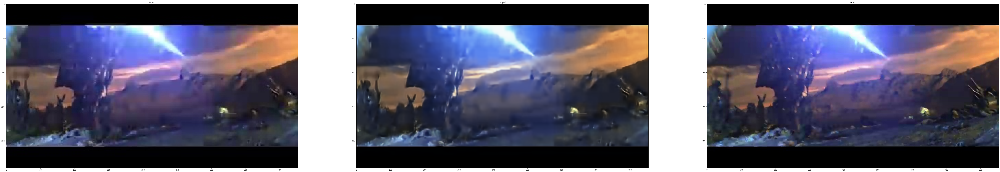

In [ ]:
i = 2
plt.figure(figsize=(100, 50))
plt.subplot(1, 3, 1)
plt.title('input')
plt.imshow(x_test[i])
plt.subplot(1, 3, 2)
plt.title('output')
plt.imshow(predict[i])
plt.subplot(1, 3, 3)
plt.title('input')
plt.imshow(y_test[i])